#Автор: Лазуков Михаил


# Описание проекта

<h3>1) Задача <h3>

В качества задачи была выбрана ***детекция текста*** или же ***scene text detection***. 

<h3>2) Выбранный детектор <h3>

Просмотрев имеющиеся архитектуры для решения данной задачи на сайте *paperswithcode.com* была выбрана DB (Differential Binarization). Данный детектор постороен на основе сегментации, т.е. на выходе мы получаем отсегментированную картику где регионы с текстовым дыделяются на постобработке. Подробнее о работе будет рассказано ниже в разделе **Обучение детектора**.

<h3>3) Набор данных <h3>

Для обучения был выборан **ICDAR2015**, т.к. он довольно часто используемые для данной задачи для оценки результатов работы.

<h3>4) Метрики <h3>

Для оценки качества работы используется 3 метрики: ***Recall, Precision, F-measure*** . Подробнее о значении данных метрик и результатах детектора будет рассказано в разделе **Тестирование детектора**.

Для понимания работы детектора обращался к статье на arxiv: https://arxiv.org/pdf/1911.08947v2.pdf.

При создании проекта опирался на репозиторий https://github.com/WenmuZhou/DBNet.pytorch из которого взял часть кода. Заимствованные части разместил на своем github в виде файлов, для удобной загрузки. Внутри ноутбука находится написанный мною код либо изменный мною код автора репозитория.

In [ ]:
# Загрузим необходимые файлы
!git clone https://github.com/mikhaillazukov/DLS-project.git
!cp -r /content/DLS-project/* ./
!pip install pyclipper

import copy
from torch.utils.data import Dataset, DataLoader
import pathlib
import os
import cv2
import numpy as np
from torchvision import transforms
from augment import *
from iaa_augment import *
from make_border_map import *
from make_shrink_map import *
from random_crop_data import *
import imgaug.augmenters as iaa
import matplotlib.pyplot as plt
import json
import pathlib
import time
import os
import glob
from natsort import natsorted
import cv2
import matplotlib.pyplot as plt
import numpy as np
from util import *
import torchvision.utils as vutils
from tqdm.notebook import tqdm
import PIL
from torch.utils.tensorboard import SummaryWriter


# Обучение детектора

#<h3>1) Подготовка данных <h3>



Данные в ICDAR2015 хранятся в формате x1, y1, x2, y2, x3, y3, x4, y4, текст. Если текст нельзя прочитать, то он отмечается как "###". 

Для обучения детектора DB на выход подается не координаты областей с текстом, а сгенерированные карты вероятностей/сегментации и порогов. Генерация происходит по алгоритму Vatti, где рассчитывается особым образом отступ для создания сжатого многоуголинка и расширенного.

<img src="https://github.com/mikhaillazukov/DLS-project/blob/main/imgs/Labegeneration.png?raw=true">

Процесс генерации карты порогов расположен в файле make_border_map.py.

Процесс генерации карты вероятностей/сегментации расположен в файле make_shrink_map.py.

Помимо этого генерируются и маски, т.к. при подсчете ошибки не учитываются области, где нельзя распознать текст, т.е. отмеченные ###. 

**Подготовка тренировочной выборки**

Перед генерацией карт порогов и карт признаков проходит аугментация данных. Происходит отражение картинок, поворот от -10 до 10 градусов и увеличение или уменьшения размера изображения. Для этого применяется библиотека imgaug, которая преобразует не только само изрображение, но и координаты боксов. Также применяется рандомное обрезание области с текстом, которое приводится к разрешению 640х640. После чего происходит нормальзация и перевод в тензор.

**Подготовка тестовой выборки**

Изображение изменяется так, чтобы меньшая сторона ровнялась 736, а также обе стороны были кратны 32.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!unzip -q /content/train_imgs.zip 
!unzip -q /content/train_gts.zip
!unzip -q /content/test_imgs.zip
!unzip -q /content/test_gts.zip

In [3]:
class ICDARCollectFN:
    def __init__(self, *args, **kwargs):
        pass

    def __call__(self, batch):
        data_dict = {}
        to_tensor_keys = []
        for sample in batch:
            for k, v in sample.items():
                if k not in data_dict:
                    data_dict[k] = []
                if isinstance(v, (np.ndarray, torch.Tensor, PIL.Image.Image)):
                    if k not in to_tensor_keys:
                        to_tensor_keys.append(k)
                data_dict[k].append(v)
        for k in to_tensor_keys:
            data_dict[k] = torch.stack(data_dict[k], 0)
        return data_dict


class ICDAR2015Dataset(Dataset):
    def __init__(self, data_path: str, img_mode, pre_processes, filter_keys, ignore_tags, transform=None, target_transform=None):
        assert img_mode in ['RGB', 'BRG', 'GRAY']
        self.ignore_tags = ignore_tags
        self.data_list = self.load_data(data_path)
        item_keys = ['img_path', 'img_name', 'text_polys', 'texts', 'ignore_tags']
        for item in item_keys:
            assert item in self.data_list[0], 'data_list from load_data must contains {}'.format(item_keys)
        self.img_mode = img_mode
        self.filter_keys = filter_keys
        self.transform = transform
        self.target_transform = target_transform
        self.aug = pre_processes
    
    def _get_annotation(self, label_path: str) -> dict:
            boxes = []
            texts = []
            ignores = []
            with open(label_path, encoding='utf-8', mode='r') as f:
                for line in f.readlines():
                    params = line.strip().strip('\ufeff').strip('\xef\xbb\xbf').split(',')
                    try:
                        box = order_points_clockwise(np.array(list(map(float, params[:8]))).reshape(-1, 2))
                        if cv2.contourArea(box) > 0:
                            boxes.append(box)
                            label = params[8]
                            texts.append(label)
                            ignores.append(label in self.ignore_tags)
                    except:
                        print('load label failed on {}'.format(label_path))
            data = {
                'text_polys': np.array(boxes),
                'texts': texts,
                'ignore_tags': ignores,
            }
            return data

    def load_data(self, data_path: str) -> list:
        data_list = get_datalist(data_path)
        t_data_list = []
        for img_path, label_path in data_list:
            data = self._get_annotation(label_path)
            if len(data['text_polys']) > 0:
                item = {'img_path': img_path, 'img_name': pathlib.Path(img_path).stem}
                item.update(data)
                t_data_list.append(item)
            else:
                print('there is no suit bbox in {}'.format(label_path))
        return t_data_list

    def apply_pre_processes(self, data):
        for aug in self.aug:
            data = aug(data)
        return data

    def __getitem__(self, index):
        try:
            data = copy.deepcopy(self.data_list[index])
            im = cv2.imread(data['img_path'], 1 if self.img_mode != 'GRAY' else 0)
            if self.img_mode == 'RGB':
                im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            data['img'] = im
            data['shape'] = [im.shape[0], im.shape[1]]
            data = self.apply_pre_processes(data)

            if self.transform:
                data['img'] = self.transform(data['img'])
            data['text_polys'] = data['text_polys'].tolist()
            if len(self.filter_keys):
                data_dict = {}
                for k, v in data.items():
                    if k not in self.filter_keys:
                        data_dict[k] = v
                return data_dict
            else:
                return data
        except:
            return self.__getitem__(np.random.randint(self.__len__()))


    def __len__(self):
        return len(self.data_list)

Для тренировочного набора данных

In [4]:
train_img_transfroms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(
        [0.485, 0.456, 0.406], 
        [0.229, 0.224, 0.225])
])

train_aug = [IaaAugment(iaa.Sequential([iaa.Fliplr(0.5),iaa.Affine(rotate=(-10, 10)),iaa.Resize((0.5, 3.0))])),
       EastRandomCropData(size = (640,640), max_tries = 50, keep_ratio = True),
       MakeBorderMap(shrink_ratio=0.4, thresh_min=0.3, thresh_max=0.7),
       MakeShrinkMap(min_text_size=8, shrink_ratio=0.4)
]
train_filter_keys = ['img_path','img_name','text_polys','texts','ignore_tags','shape']
train_ignore_tags = ['*', '###']
train_collate_fn = None
train_img_mode = 'RGB'
train_dataset_name = 'ICDAR2015Dataset'
train_data_path = ['/content/train_imgs', '/content/train_gts' ]

Для тестового набора данных



In [5]:
test_img_transfroms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(
        [0.485, 0.456, 0.406], 
        [0.229, 0.224, 0.225])
])

test_aug = [ResizeShortSize(short_size=736, resize_text_polys = False)]
test_collate_fn = ICDARCollectFN()
test_filter_keys = []
test_ignore_tags = ['*', '###']
test_img_mode = 'RGB'
test_dataset_name = 'ICDAR2015Dataset'
test_data_path = ['/content/test_imgs', '/content/test_gts' ]

In [6]:
train_dataset = ICDAR2015Dataset(data_path=train_data_path, transform=train_img_transfroms, pre_processes=train_aug, filter_keys=train_filter_keys, ignore_tags=train_ignore_tags, img_mode=train_img_mode)
test_dataset = ICDAR2015Dataset(data_path=test_data_path, transform=test_img_transfroms, pre_processes=test_aug, filter_keys=test_filter_keys, ignore_tags=test_ignore_tags, img_mode=test_img_mode)

train_loader = DataLoader(dataset=train_dataset, batch_size=16, shuffle=True, num_workers=2, collate_fn=train_collate_fn)
validate_loader = DataLoader(dataset=test_dataset, batch_size=1, shuffle=False, num_workers=2, collate_fn=test_collate_fn)

In [7]:
def imshow(inp, title=None, plt_ax=plt, default=False):
    """Imshow для тензоров"""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt_ax.imshow(inp)
    if title is not None:
        plt_ax.set_title(title)
    plt_ax.grid(False)

torch.Size([3, 640, 640])

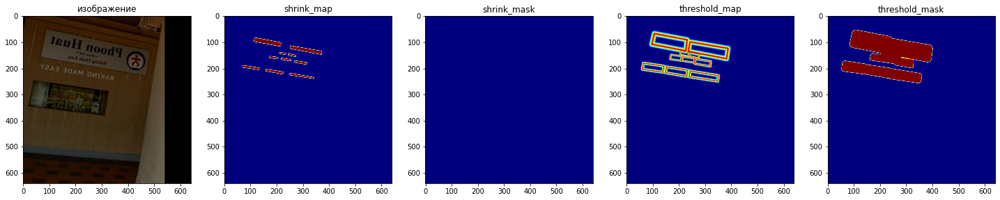

In [8]:
fig, axes = plt.subplots(1, 5)

samples = next(iter(train_loader))

imshow(samples['img'][0], 'изображение', axes[0])

axes[1].imshow(samples['shrink_map'][0], cmap='jet')
axes[1].set_title('shrink_map')

axes[2].imshow(samples['shrink_mask'][0], cmap='jet')
axes[2].set_title('shrink_mask')

axes[3].imshow(samples['threshold_map'][0], cmap='jet')
axes[3].set_title('threshold_map')

axes[4].imshow(samples['threshold_mask'][0], cmap='jet')
axes[4].set_title('threshold_mask')

fig.set_figwidth(25)    #  ширина и
fig.set_figheight(5)    #  высота "Figure"

samples['img'][0].size()

# <h3>2)Создаем модель<h3>

В работе хотелось создать более быструю модель, поэтому решено было поставить в качестве Backbone сеть с достаточно малым числом параметров, но при этом чтобы из нее можно было извлечь карты признаков разных размеров для FPN. Была выбрана сеть SqueezeNet v1.1. Также ввиду того, что в оригинальной модели DB из backbone берутся 4 карты признаков (уменьшенная в 4,8,16,32 раза соответственные), а SqueezeNet v1.1 умешает изображение только в 16 раз пришлось внести некоторые правки в FPN. Ниже представлена схема полученной архитектуры.

<img src="https://github.com/mikhaillazukov/DLS-project/blob/main/imgs/dbnet.png?raw=True">


In [9]:
import torchvision
from torch import nn
import torch.nn.functional as F

class SqueezeNet(nn.Module):
    def __init__(self, pretrained=True):
        super().__init__()
        self.out_channels = [128, 256, 512]
        net = torchvision.models.squeezenet1_1(pretrained=pretrained)
        features = net.features
        self.layer1 = nn.Sequential(*features[0:5])
        self.layer2 = nn.Sequential(*features[5:8])
        self.layer3 = nn.Sequential(*features[8:])

    def forward(self, x):
        enc0 = self.layer1(x)
        enc1 = self.layer2(enc0)
        enc2 = self.layer3(enc1)
        return [enc0, enc1, enc2]


class ConvBnRelu(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True, padding_mode='zeros', inplace=True):
        super().__init__()
        self.conv = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, dilation=dilation,
                              groups=groups, bias=bias, padding_mode=padding_mode)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=inplace)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        x = self.relu(x)
        return x


class FPN(nn.Module):
    def __init__(self, in_channels, inner_channels=192, **kwargs):
        super().__init__()
        inplace = True
        self.conv_out = inner_channels
        inner_channels = inner_channels // 3

        self.reduce_conv_c2 = ConvBnRelu(in_channels[0], inner_channels, kernel_size=1, inplace=inplace)
        self.reduce_conv_c3 = ConvBnRelu(in_channels[1], inner_channels, kernel_size=1, inplace=inplace)
        self.reduce_conv_c4 = ConvBnRelu(in_channels[2], inner_channels, kernel_size=1, inplace=inplace)

        self.smooth_p3 = ConvBnRelu(inner_channels, inner_channels, kernel_size=3, padding=1, inplace=inplace)
        self.smooth_p2 = ConvBnRelu(inner_channels, inner_channels, kernel_size=3, padding=1, inplace=inplace)
        self.conv = nn.Sequential(
            nn.Conv2d(self.conv_out, self.conv_out, kernel_size=3, padding=1, stride=1),
            nn.BatchNorm2d(self.conv_out),
            nn.ReLU(inplace=inplace)
        )
        self.out_channels = self.conv_out

    def forward(self, x):
        c2, c3, c4 = x

        p4 = self.reduce_conv_c4(c4)
        p3 = self._upsample_add(p4, self.reduce_conv_c3(c3))
        p3 = self.smooth_p3(p3)
        p2 = self._upsample_add(p3, self.reduce_conv_c2(c2))
        p2 = self.smooth_p2(p2)

        x = self._upsample_cat(p2, p3, p4)
        x = self.conv(x)

        return x

    def _upsample_add(self, x, y):
        return F.interpolate(x, size=y.size()[2:]) + y

    def _upsample_cat(self, p2, p3, p4):
        h, w = p2.size()[2:]
        p3 = F.interpolate(p3, size=(h, w))
        p4 = F.interpolate(p4, size=(h, w))
        return torch.cat([p2, p3, p4], dim=1)


class DBHead(nn.Module):
    def __init__(self, in_channels, out_channels, k = 50):
        super().__init__()
        self.k = k
        self.binarize = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // 4, 3, padding=1),
            nn.BatchNorm2d(in_channels // 4),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels // 4, in_channels // 4, 2, 2),
            nn.BatchNorm2d(in_channels // 4),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(in_channels // 4, 1, 2, 2),
            nn.Sigmoid())
        self.binarize.apply(self.weights_init)

        self.thresh = self._init_thresh(in_channels)
        self.thresh.apply(self.weights_init)

    def forward(self, x):
        shrink_maps = self.binarize(x)
        if self.training:
            threshold_maps = self.thresh(x)
            binary_maps = self.step_function(shrink_maps, threshold_maps)
            y = torch.cat((shrink_maps, threshold_maps, binary_maps), dim=1)
        else:
            y = shrink_maps
        return y

    def weights_init(self, m):
        classname = m.__class__.__name__
        if classname.find('Conv') != -1:
            nn.init.kaiming_normal_(m.weight.data)
        elif classname.find('BatchNorm') != -1:
            m.weight.data.fill_(1.)
            m.bias.data.fill_(1e-4)

    def _init_thresh(self, inner_channels, serial=False, smooth=False, bias=False):
        in_channels = inner_channels
        if serial:
            in_channels += 1
        self.thresh = nn.Sequential(
            nn.Conv2d(in_channels, inner_channels // 4, 3, padding=1, bias=bias),
            nn.BatchNorm2d(inner_channels // 4),
            nn.ReLU(inplace=True),
            self._init_upsample(inner_channels // 4, inner_channels // 4, smooth=smooth, bias=bias),
            nn.BatchNorm2d(inner_channels // 4),
            nn.ReLU(inplace=True),
            self._init_upsample(inner_channels // 4, 1, smooth=smooth, bias=bias),
            nn.Sigmoid())
        return self.thresh

    def _init_upsample(self, in_channels, out_channels, smooth=False, bias=False):
        if smooth:
            inter_out_channels = out_channels
            if out_channels == 1:
                inter_out_channels = in_channels
            module_list = [
                nn.Upsample(scale_factor=2, mode='nearest'),
                nn.Conv2d(in_channels, inter_out_channels, 3, 1, 1, bias=bias)]
            if out_channels == 1:
                module_list.append(nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1, padding=1, bias=True))
            return nn.Sequential(module_list)
        else:
            return nn.ConvTranspose2d(in_channels, out_channels, 2, 2)

    def step_function(self, x, y):
        return torch.reciprocal(1 + torch.exp(-self.k * (x - y)))


class Model(nn.Module):
    def __init__(self, pretrained=True):
        super().__init__()
        self.backbone = SqueezeNet(pretrained)
        self.neck = FPN(in_channels=self.backbone.out_channels)
        self.head = DBHead(in_channels=self.neck.out_channels, out_channels=2, k=50)

        self.name = 'SqueezeNet_FPN_DBHead'

    def forward(self, x):
        _, _, H, W = x.size()
        backbone_out = self.backbone(x)
        neck_out = self.neck(backbone_out)
        y = self.head(neck_out)
        y = F.interpolate(y, size=(H, W), mode='bilinear', align_corners=True)
        return y

In [10]:
dbnet = Model()

Downloading: "https://download.pytorch.org/models/squeezenet1_1-b8a52dc0.pth" to /root/.cache/torch/hub/checkpoints/squeezenet1_1-b8a52dc0.pth


# <h3>3) Обучение<h3>

<h3>Постпроцессинг<h3>

Реализован благодаря opencv, в которой используются функции для выделения контуров и поиска минимального четырехугольника способного описать эти контуры

In [11]:
from postprocess import *
post_p = PostProcessing(thresh=0.3, box_thresh=0.7, max_candidates=1000, unclip_ratio=1.5)

<h3> Функция ошибки <h3>

Функция ошибки состоит из суммы трех:


1.   L1 loss для карты порогов
2.   Dice loss для бинарной карты
3.   BCE loss для карты вероятностей




In [12]:
from loss import *
criterion = DBLoss(alpha=1.0, beta=10, ohem_ratio=3)

<h3> Метрики <h3>

Реализуется подсчет Recall, Precision, F-measure.

Подсчитывается несколько значений, а именно обещее число рамок на изображении, число рамок в предсказании, число верно отмеченных рамок, число рамок на исходном изображении, которые не участвуют в подсчете метрик, число предсказанных рамок, которые не участыуют в подсчете метрик. Не участвуют те рамки,где текст разобрать нельзя (отмечены в датасете как ###). Данная функция используется в eval, которая собирает общее число параметров и вычисляет уже итоговое значение метрики. Таким образом метрика считается по всем текстовым областям на выборке сразу, а не по каждой картинке, т.к. может быть ситуация, когда на одной картинке отсутствуют. 

In [13]:
from shapely.geometry import Polygon
import numpy as np
import PIL


def get_intersection(pD,pG):
    return Polygon(pD).intersection(Polygon(pG)).area

def get_union(pD,pG):
    return Polygon(pD).union(Polygon(pG)).area

def get_intersection_over_union(pD,pG):
    return get_intersection(pD, pG) / get_union(pD, pG)


def evaluate_image(gt, results):
    BLANK_IOU = 0.5
    IOU = 0.5
    result_blank = 0
    gt_blank = 0
    true_positive = 0
    gt_num = 0
    res_num = 0

    iou_mat = np.empty([len(gt),len(results)],dtype='float32')

    for i in range(len(gt)):
        if gt[i]['ignore']:
          gt_blank += 1
        for j in range(len(results)):
            iou_mat[i, j] = get_intersection_over_union(gt[i]['points'], results[j]['points'])

    if len(results) > 0:
        for i in range(len(gt)):
            for j in range(len(results)):
                intersected_area = get_intersection(gt[i]['points'], results[j]['points'])
                pdDimensions = Polygon(results[j]['points']).area
                precision = 0 if pdDimensions == 0 else intersected_area / pdDimensions
                if gt[i]['ignore'] and precision > BLANK_IOU:
                    result_blank += 1

            j = np.argmax(iou_mat[i])
            if iou_mat[i, j] >= IOU and not gt[i]['ignore']:
                true_positive += 1
    gt_num += len(gt)
    res_num += len(results)
    return gt_num, res_num, gt_blank, result_blank, true_positive

def eval(model, post_p ,val_loader):
    model.eval()
    global_result_blank = 0
    global_gt_blank = 0
    global_true_positive = 0
    global_gt_num = 0
    global_res_num = 0
    box_thresh = 0.7
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    for i, batch in tqdm(enumerate(val_loader), total=len(val_loader)):
        with torch.no_grad():
            for key, value in batch.items():
                if value is not None:
                    if isinstance(value, torch.Tensor):
                        batch[key] = value.to(device)
            preds = model(batch['img'])
            boxes, scores = post_p(batch, preds, False)

            gt_polyons_batch = batch['text_polys']
            ignore_tags_batch = batch['ignore_tags']
            pred_polygons_batch = np.array(boxes)
            pred_scores_batch = np.array(scores)
            for polygons, pred_polygons, pred_scores, ignore_tags in \
                    zip(gt_polyons_batch, pred_polygons_batch, pred_scores_batch, ignore_tags_batch):
                gt = [dict(points=polygons[i], ignore=ignore_tags[i])
                      for i in range(len(polygons))]

                pred = []
                for i in range(pred_polygons.shape[0]):
                    if pred_scores[i] >= box_thresh:
                        pred.append(dict(points=pred_polygons[i, :, :].tolist()))

                gt_num, res_num, gt_blank, result_blank, true_positive = evaluate_image(gt, pred)
                global_gt_num += gt_num
                global_res_num += res_num
                global_gt_blank += gt_blank
                global_result_blank += result_blank
                global_true_positive += true_positive

    recall = 0 if global_gt_num - global_gt_blank == 0 else 1.0 * global_true_positive / (global_gt_num - global_gt_blank) * 100
    precision = 0 if global_res_num - global_result_blank == 0 else 1.0 * global_true_positive / (global_res_num - global_result_blank) * 100
    f = 0 if recall + precision == 0 else 2 * recall * precision / (recall + precision)

    return recall, precision, f

<h3> Функция обучения <h3>


In [35]:
def fit(model, criterion, optimizer, scheduler, epochs, post_p, train_loader, val_loader, log_dir, tensorboard_enable = True, resume = ""):
    
    start_epoch = 0
    global_step = 0

    model.train()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    writer = None
    save_dir = os.path.join(log_dir, model.name)
    if tensorboard_enable:
      writer = SummaryWriter(save_dir)
    
    checkpoint_dir=os.path.join(save_dir, 'checkpoint')
    os.makedirs(checkpoint_dir, exist_ok = True)
    metrics = {'recall': 0, 'precision': 0, 'fmeasure': 0, 'train_loss': float('inf'), 'best_model_epoch':0}

    if resume != "":
      print('Loading checkpoint')
      checkpoint = torch.load(resume, map_location=torch.device('cpu'))
      model.load_state_dict(checkpoint['state_dict'])
      global_step = checkpoint['global_step']
      start_epoch = checkpoint['epoch']
      optimizer.load_state_dict(checkpoint['optimizer'])
      scheduler.load_state_dict(checkpoint['scheduler'])       
      metrics = checkpoint['metrics']
      print("resume from checkpoint {} (epoch {})".format(resume, start_epoch))

    for epoch in range(start_epoch, epochs): 
        if epoch == 0:
          requires_grad_backbone(model, False)
        elif epoch == 75:
          requires_grad_backbone(model, True)
        train_loss = 0
        model.train()
        for i, batch in tqdm(enumerate(train_loader), total=len(train_loader)):            
            for key, value in batch.items():
                if value is not None:
                    if isinstance(value, torch.Tensor):
                        batch[key] = value.to(device)
            cur_batch_size = batch['img'].size()[0]

            preds = model(batch['img'])
            loss_dict = criterion(preds, batch)
            optimizer.zero_grad()
            loss_dict['loss'].backward()
            optimizer.step()
            scheduler.step()

            train_loss += loss_dict['loss']
                 
            if writer != None:
              for key, value in loss_dict.items():
                 writer.add_scalar('TRAIN/LOSS/{}'.format(key), value, global_step)

            if global_step % 50 == 0 and writer != None:
              inverse_normalize(batch['img'])
              writer.add_images('TRAIN/imgs', batch['img'], global_step)
              shrink_labels = batch['shrink_map']
              threshold_labels = batch['threshold_map']
              shrink_labels[shrink_labels <= 0.5] = 0
              shrink_labels[shrink_labels > 0.5] = 1
              show_label = torch.cat([shrink_labels, threshold_labels])
              show_label = vutils.make_grid(show_label.unsqueeze(1), nrow=cur_batch_size, normalize=False, padding=20, pad_value=1)
              writer.add_image('TRAIN/gt', show_label, global_step)
              show_pred = []
              for kk in range(preds.shape[1]):
                  show_pred.append(preds[:, kk, :, :])
              show_pred = torch.cat(show_pred)
              show_pred = vutils.make_grid(show_pred.unsqueeze(1), nrow=cur_batch_size, normalize=False, padding=20, pad_value=1)
              writer.add_image('TRAIN/preds', show_pred, global_step)
                          
            global_step += 1
        
        recall, precision, f = eval(model, post_p, val_loader)

        if writer != None:
          writer.add_scalar("Val/Recall", recall, global_step)
          writer.add_scalar("Val/Precision", precision, global_step)
          writer.add_scalar("Val/Fmeasure", f, global_step)
        
        loss = train_loss / len(train_loader)
        print("Epoch [{}/{}], loss: {:.4f}, recall: {:.4f}, precision: {:.4f}, f-measure: {:.4f}".format(
                          epoch+1, epochs, 
                          loss, 
                          recall, 
                          precision,
                          f))
        file_name = 'last_checkpoint.pth'
        if f > metrics['fmeasure'] or loss <= metrics['train_loss']:
          metrics['best_model_epoch'] = epoch
          file_name = 'best_checkpoint.pth'

        metrics['recall'] = recall
        metrics['precision'] = precision
        metrics['fmeasure'] = f
        metrics['train_loss'] = loss
        state = {
            'epoch': epoch,
            'global_step': global_step,
            'state_dict': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'metrics': metrics,
            'scheduler': scheduler.state_dict()
        }
        filename = os.path.join(checkpoint_dir, file_name)
        torch.save(state, filename)

In [16]:
def inverse_normalize(batch_img):
  normalize_mean = torch.FloatTensor([0.485, 0.456, 0.406])
  normalize_std = torch.FloatTensor([0.229, 0.224, 0.225])
  batch_img[:, 0, :, :] = batch_img[:, 0, :, :] * normalize_std[0] + normalize_mean[0]
  batch_img[:, 1, :, :] = batch_img[:, 1, :, :] * normalize_std[1] + normalize_mean[1]
  batch_img[:, 2, :, :] = batch_img[:, 2, :, :] * normalize_std[2] + normalize_mean[2]

In [17]:
def requires_grad_backbone(model, requires = True):
  for param in model.backbone.layer1.parameters():
    param.requires_grad = requires
  for param in model.backbone.layer2.parameters():
    param.requires_grad = requires
  for param in model.backbone.layer3.parameters():
    param.requires_grad = requires

In [18]:
log_dir = '/content/logdir/'
epochs = 400
lr = 0.001
optimizer = torch.optim.Adam(dbnet.parameters(), lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, 50, 0.8)

In [ ]:
fit(dbnet, criterion, optimizer, scheduler, epochs, post_p, train_loader, validate_loader, log_dir, resume="/content/drive/MyDrive/SqueezeNet_FPN_DBHead/checkpoint/best_checkpoint.pth")

При обучении до 75 эпохи градиенты backbone сети заморожены, после 75 эпохи они размораживаются и обучается вся сеть. Это сделано с той идеей, чтобы в самом начале обучения веса предобученной backbone сети не потерялись на первом же обратном проходе. Момент, когда был разморожен градиент четко виден на графике тензорборда.

В тензорборд сохраняются ошибки, метрики и картики работы сети в ходе обучения. Т.к. сеть обучалась на разных аккаунтах, то части тензорборда сохранены в разных местах и поэтому ниже видно только результаты для части обучения.

In [37]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir '/content/drive/MyDrive/SqueezeNet_FPN_DBHead'

<IPython.core.display.Javascript object>

# <h3>4) Тестирование<h3>

In [69]:
def test(model, test_loader, post_p):
  model.eval()
  global_result_blank = 0
  global_gt_blank = 0
  global_true_positive = 0
  global_gt_num = 0
  global_res_num = 0
  box_thresh = 0.7
  device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
  model.to(device)
  total_frame = 0.0
  total_time = 0.0
  for i, batch in tqdm(enumerate(test_loader), total=len(test_loader)):
      with torch.no_grad():
          for key, value in batch.items():
              if value is not None:
                  if isinstance(value, torch.Tensor):
                      batch[key] = value.to(device)
          start = time.time()
          preds = model(batch['img'])
          boxes, scores = post_p(batch, preds, False)
          total_frame += batch['img'].size()[0]
          total_time += time.time() - start

          gt_polyons_batch = batch['text_polys']
          ignore_tags_batch = batch['ignore_tags']
          pred_polygons_batch = np.array(boxes)
          pred_scores_batch = np.array(scores)
          for polygons, pred_polygons, pred_scores, ignore_tags in \
                  zip(gt_polyons_batch, pred_polygons_batch, pred_scores_batch, ignore_tags_batch):
              gt = [dict(points=polygons[i], ignore=ignore_tags[i])
                    for i in range(len(polygons))]

              pred = []
              for i in range(pred_polygons.shape[0]):
                  if pred_scores[i] >= box_thresh:
                      pred.append(dict(points=pred_polygons[i, :, :].tolist()))

              gt_num, res_num, gt_blank, result_blank, true_positive = evaluate_image(gt, pred)
              global_gt_num += gt_num
              global_res_num += res_num
              global_gt_blank += gt_blank
              global_result_blank += result_blank
              global_true_positive += true_positive

  recall = 0 if global_gt_num - global_gt_blank == 0 else 1.0 * global_true_positive / (global_gt_num - global_gt_blank) * 100
  precision = 0 if global_res_num - global_result_blank == 0 else 1.0 * global_true_positive / (global_res_num - global_result_blank) * 100
  f = 0 if recall + precision == 0 else 2 * recall * precision / (recall + precision)
  
  print('FPS:{}'.format(total_frame / total_time))
  print('test: recall: {:.6f}, precision: {:.6f}, f1: {:.6f}'.format(recall, precision, f))
      

In [ ]:
checpoint = torch.load('/content/db_squeezenet.pth')
dbnet.load_state_dict(checpoint['state_dict'])

In [70]:
test(dbnet, validate_loader, post_p)


FPS:28.66626820206852
test: recall: 63.728814, precision: 83.608640, f1: 72.327563


# Результаты работы

Результаты работы 

Получена модель со следующими метриками:


*   FPS - 28.66
*   Recall - 63.72
*   Presicion - 83.60
*   F-мера - 72.32






<img src="https://github.com/mikhaillazukov/DLS-project/blob/main/imgs/example.png?raw=true">

<img src="https://github.com/mikhaillazukov/DLS-project/blob/main/imgs/result.gif?raw=true">

<img src="https://github.com/mikhaillazukov/DLS-project/blob/main/imgs/result2.gif?raw=true">

In [55]:
def draw_bbox(img_path, result, color=(0, 255, 0), thickness=2):
    if isinstance(img_path, str):
        img_path = cv2.imread(img_path)
        img_path = cv2.cvtColor(img_path,cv2.COLOR_BGR2RGB)
        
    img_path = img_path.copy()
    for point in result:
        point = point.astype(int)
        cv2.polylines(img_path, [point], True, color, thickness)
    return img_path

In [66]:
def detect_text(model, post_p, batch):
  device = 'cpu'
  model.eval()
  model.to(device)
  preds = model(batch['img'].to(device))
  box_list, score_list = post_p(batch, preds, is_output_polygon=False)
  box_list, score_list = box_list[0], score_list[0]
  if len(box_list) > 0:
          idx = box_list.reshape(box_list.shape[0], -1).sum(axis=1) > 0
          box_list, score_list = box_list[idx], score_list[idx]
  else:
      box_list, score_list = [], []
  plt.imshow(draw_bbox(batch['img_path'][0],box_list ))
  plt.show()

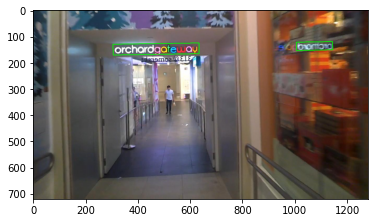

In [67]:
batch = next(iter(validate_loader))
detect_text(dbnet, post_p, batch)